In [1]:
# Import the required packages
import numpy as np
from scipy.fft import fft, rfft
from scipy.fft import fftfreq, rfftfreq
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import librosa

In [2]:
# Load audio file
filename = "noida_song.m4a"
y, sr = librosa.load(filename)

/var/folders/zq/gw91vncx7hgcs9mspyj7dtk40000gn/T/ipykernel_69846/174510590.py:3: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(filename)
/usr/local/lib/python3.9/site-packages/librosa/core/audio.py:183: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


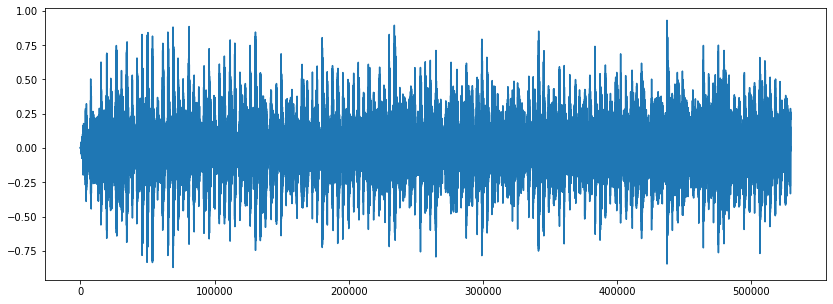

In [3]:
plt.figure(figsize=(14, 5))
plt.plot(y)

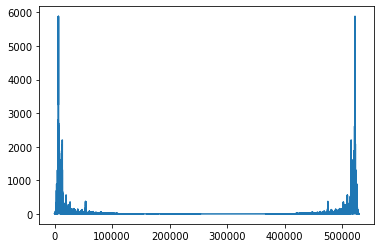

In [4]:
# Apply the FFT on the signal
fourier = fft(y)

# Plot the result (the spectrum |Xk|)
plt.plot(np.abs(fourier))
plt.show()

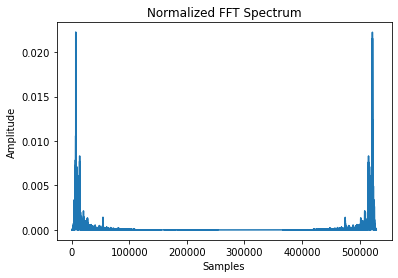

In [5]:
# Calculate N/2 to normalize the FFT output
N = len(y)
normalize = N/2

# Plot the normalized FFT (|Xk|)/(N/2)
plt.plot(np.abs(fourier)/normalize)
plt.ylabel('Amplitude')
plt.xlabel('Samples')
plt.title('Normalized FFT Spectrum')
plt.show()

In [6]:
# Calculate N/2 for normalization
N = len(y)
normalize = N/2

# Normalize the FFT output
normalized_fft = np.abs(fourier) / normalize

# Create the Plotly figure
fig = go.Figure(data=go.Scatter(
    x=np.arange(len(normalized_fft)),
    y=normalized_fft,
    mode='lines',  # Connect data points with lines
    name='Normalized FFT Spectrum'
))

# Customize the plot
fig.update_layout(
    title='Normalized FFT Spectrum',
    xaxis_title='Samples',
    yaxis_title='Amplitude'
)

# Show the interactive plot
fig.show()

In [ ]:
import numpy as np
from scipy.signal import butter, lfilter

# Define filter parameters
cutoff_frequency = 55000  # Hz
sampling_frequency = 1/ np.mean(np.diff()) # Hz
order = 4  # Filter order

# Design the filter
b, a = butter(order, cutoff_frequency / (sampling_frequency / 2), btype='low')

# Generate a noisy signal for demonstration
t = np.linspace(0, 1, sampling_frequency, endpoint=False)
noisy_signal = np.sin(2 * np.pi * 300 * t) + 0.5 * np.random.randn(len(t))

# Apply the filter to the noisy signal
filtered_signal = lfilter(b, a, noisy_signal)

In [7]:
# # Load the audio file
# filename = "noida_song.m4a"  # Replace with your actual file path
# y, sr = librosa.load(filename)

# # Time domain plot
# plt.figure(figsize=(14, 5))
# plt.plot(y)
# plt.xlabel("Time (samples)")
# plt.ylabel("Amplitude")
# plt.title("Time Domain Signal")
# plt.show()

# # Frequency domain plot
# # Y = librosa.stft(y)  # Short-time Fourier transform
# # plt.figure(figsize=(14, 5))
# # plt.imshow(Ydb, aspect="auto", origin="lower", cmap="magma")
# # plt.colorbar(format="%+2.0f dB")
# # plt.xlabel("Time (frames)")
# # plt.ylabel("Frequency (Hz)")
# # plt.title("Frequency Domain Representation (Spectrogram)")
# # plt.show()
# # Calculate the frequencies for the x-axis
# f = librosa.fft_frequencies(sr=sr, n_fft=2048)  # Adjust n_fft if needed
# # Ydb = librosa.amplitude_to_db(abs(f), ref=np.max)  # Convert to decibels

# # Plot the frequency domain representation
# plt.figure(figsize=(14, 5))
# plt.plot(f[:len(Ydb)], Ydb[0])  # Plot first row of Ydb (amplitudes)
# plt.xlabel("Frequency (Hz)")
# plt.ylabel("Amplitude (dB)")
# plt.title("Frequency Domain Representation")
# plt.show()